# Architecture 1: DCGAN, WGAN, and WGAN-GP Results

In [1]:
import struct
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
import joblib
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score
import random
import gzip
import shutil
import os
import matplotlib.pyplot as plt
import math
import itertools
import imageio
import natsort
from glob import glob
import torchvision.transforms as transforms
from PIL import Image
import torchvision.utils as vutils
import matplotlib.animation as animation
from IPython.display import HTML
import torchvision

In [2]:
!wget -nc http://fashion-mnist.s3-website.eu-central-1.amazonaws.com/train-images-idx3-ubyte.gz
!wget -nc http://fashion-mnist.s3-website.eu-central-1.amazonaws.com/train-labels-idx1-ubyte.gz
!wget -nc http://fashion-mnist.s3-website.eu-central-1.amazonaws.com/t10k-images-idx3-ubyte.gz
!wget -nc http://fashion-mnist.s3-website.eu-central-1.amazonaws.com/t10k-labels-idx1-ubyte.gz

# Unzip the downloaded files
!gunzip -k train-images-idx3-ubyte.gz
!gunzip -k train-labels-idx1-ubyte.gz
!gunzip -k t10k-images-idx3-ubyte.gz
!gunzip -k t10k-labels-idx1-ubyte.gz

--2024-10-15 15:24:18--  http://fashion-mnist.s3-website.eu-central-1.amazonaws.com/train-images-idx3-ubyte.gz
Resolving fashion-mnist.s3-website.eu-central-1.amazonaws.com (fashion-mnist.s3-website.eu-central-1.amazonaws.com)... 3.5.134.14, 52.219.168.24, 52.219.169.136, ...
Connecting to fashion-mnist.s3-website.eu-central-1.amazonaws.com (fashion-mnist.s3-website.eu-central-1.amazonaws.com)|3.5.134.14|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 26421880 (25M) [binary/octet-stream]
Saving to: ‘train-images-idx3-ubyte.gz’

train-images-idx3-u 100%[===================>]  25.20M  5.22MB/s    in 6.2s    

2024-10-15 15:24:24 (4.08 MB/s) - ‘train-images-idx3-ubyte.gz’ saved [26421880/26421880]

--2024-10-15 15:24:24--  http://fashion-mnist.s3-website.eu-central-1.amazonaws.com/train-labels-idx1-ubyte.gz
Resolving fashion-mnist.s3-website.eu-central-1.amazonaws.com (fashion-mnist.s3-website.eu-central-1.amazonaws.com)... 52.219.46.92, 3.5.136.124, 52.219.208.20

## Ingest

In [3]:
def read_idx(file_path):
    with open(file_path, 'rb') as f:
        magic_number, size = struct.unpack('>II', f.read(8))
        if magic_number == 2051:  # 2051 code for images
            rows, cols = struct.unpack('>II', f.read(8))
            data = np.fromfile(f, dtype=np.uint8).reshape(size, rows, cols)
        elif magic_number == 2049:  # 2049 code for labels
            data = np.fromfile(f, dtype=np.uint8)
        else:
            raise ValueError('Invalid IDX file')
    return data

train_images = read_idx('train-images-idx3-ubyte')
train_labels = read_idx('train-labels-idx1-ubyte')

test_images = read_idx('t10k-images-idx3-ubyte')
test_labels = read_idx('t10k-labels-idx1-ubyte')

train_images = train_images.astype(np.float32) / 255.0
test_images = test_images.astype(np.float32) / 255.0

In [4]:
class FashionMNISTDataset(Dataset):
    def __init__(self, images, labels, transform=None):
        self.images = images
        self.labels = labels
        self.transform = transform

    def __len__(self):
        return len(self.labels)

    def __getitem__(self, idx):
        image = self.images[idx]
        label = self.labels[idx]
        if self.transform:
            image = self.transform(image)
        return image, label

In [5]:
transform = transforms.Compose([
    transforms.ToPILImage(),   # Convert tensor to PIL image
    transforms.Resize((64, 64)), # Resize to 64x64
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),# Convert PIL image back to tensor
])

combined_images = np.concatenate((train_images, test_images), axis=0)
combined_labels = np.concatenate((train_labels, test_labels), axis=0)

combined_dataset = FashionMNISTDataset(combined_images, combined_labels, transform=transform)

train_loader = DataLoader(dataset=combined_dataset, batch_size=128, shuffle=True, num_workers=2)


# Architecture 1:


[
nonlinG: ReLU,
nonlinD: LeakyReLU,
depthG: 4,
depthD: 4,
batchnormG: True,
batchnormD: True,
FilterG: 64,
filterD: 64
]

In [452]:
# Batch size during training
batch_size = 128

image_size = 64

nc = 1

nz = 100

ngf = 64

ndf = 64

num_epochs = 5

lr = 0.0002

beta1 = 0.5

ngpu = 1

## Weight Initialization

In [453]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

## DCGAN

### Generator

In [8]:
class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
        )

    def forward(self, input):
        return self.main(input)

### Discriminator

In [9]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(

            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

### Instantiating networks and weights

In [10]:
device = torch.device("cuda:0" if (torch.cuda.is_available() ) else "cpu")

netG = Generator(ngpu).to(device)
netG.apply(weights_init)


netD = Discriminator(ngpu).to(device)
netD.apply(weights_init)

print(netD)
print(netG)

Discriminator(
  (main): Sequential(
    (0): Conv2d(1, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)
Generator(
  (main): Sequentia

### Additional pre-train setup

In [53]:
criterion = nn.BCELoss()

fixed_noise = torch.randn(64, nz, 1, 1, device=device)

real_label = 1.
fake_label = 0.

optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

## Training

*   saving generator state at end
*   generator losses saved
*   discriminator losses saved






In [54]:
save_path_a1_dcgan = "./generator_weights_a1_dgcan.pth"
img_list_dgcan_a1 = []
g_dcgan_a1_losses = []
d_dcgan_a1_losses = []
iters = 0

print("Starting Training Loop...")
for epoch in range(num_epochs):
    for i, data in enumerate(train_loader, 0):

        netD.zero_grad()
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        output = netD(real_cpu).view(-1)
        errD_real = criterion(output, label)
        errD_real.backward()
        D_x = output.mean().item()

        noise = torch.randn(b_size, nz, 1, 1, device=device)
        fake = netG(noise)
        label.fill_(fake_label)
        output = netD(fake.detach()).view(-1)
        errD_fake = criterion(output, label)
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        errD = errD_real + errD_fake
        optimizerD.step()

        netG.zero_grad()
        label.fill_(real_label)
        output = netD(fake).view(-1)
        errG = criterion(output, label)
        errG.backward()
        D_G_z2 = output.mean().item()
        optimizerG.step()

        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(train_loader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        g_dcgan_a1_losses.append(errG.item())
        d_dcgan_a1_losses.append(errD.item())

        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(train_loader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list_dgcan_a1.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

torch.save(netG.state_dict(), save_path_a1_dcgan)
print(f"Generator weights saved to {save_path_a1_dcgan}")

Starting Training Loop...
[0/5][0/547]	Loss_D: 0.3175	Loss_G: 17.0182	D(x): 0.9790	D(G(z)): 0.2308 / 0.0000
[0/5][50/547]	Loss_D: 1.8958	Loss_G: 11.4010	D(x): 0.7414	D(G(z)): 0.4328 / 0.0001
[0/5][100/547]	Loss_D: 0.4211	Loss_G: 5.7293	D(x): 0.9524	D(G(z)): 0.2843 / 0.0059
[0/5][150/547]	Loss_D: 0.3090	Loss_G: 2.7963	D(x): 0.8039	D(G(z)): 0.0415 / 0.1063
[0/5][200/547]	Loss_D: 0.2977	Loss_G: 2.5968	D(x): 0.9542	D(G(z)): 0.1362 / 0.1775
[0/5][250/547]	Loss_D: 0.3805	Loss_G: 5.9870	D(x): 0.9527	D(G(z)): 0.2418 / 0.0058
[0/5][300/547]	Loss_D: 0.8715	Loss_G: 7.1258	D(x): 0.9629	D(G(z)): 0.4896 / 0.0038
[0/5][350/547]	Loss_D: 0.3658	Loss_G: 3.4084	D(x): 0.8878	D(G(z)): 0.1884 / 0.0640
[0/5][400/547]	Loss_D: 0.4653	Loss_G: 2.7903	D(x): 0.8577	D(G(z)): 0.2291 / 0.0927
[0/5][450/547]	Loss_D: 0.3824	Loss_G: 2.6067	D(x): 0.7805	D(G(z)): 0.0807 / 0.1117
[0/5][500/547]	Loss_D: 0.3494	Loss_G: 2.8133	D(x): 0.8033	D(G(z)): 0.0930 / 0.0982
[1/5][0/547]	Loss_D: 0.5258	Loss_G: 4.6416	D(x): 0.9180	D(G(z)

## DCGAN Architecture 1 Images and Losses

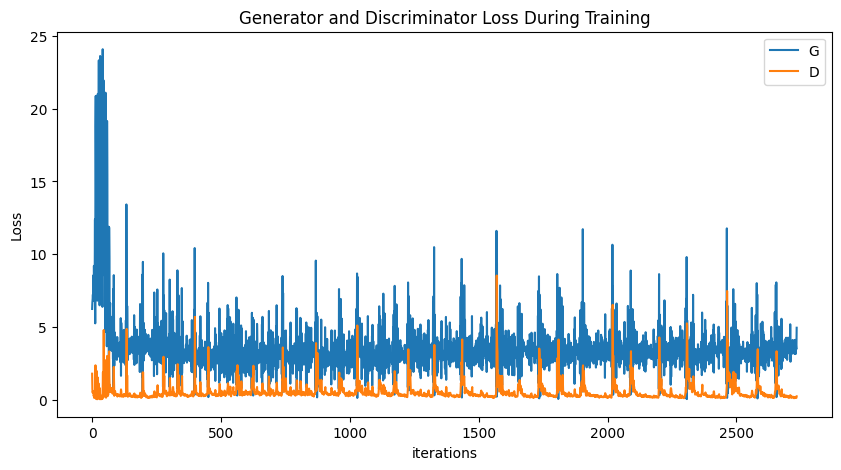

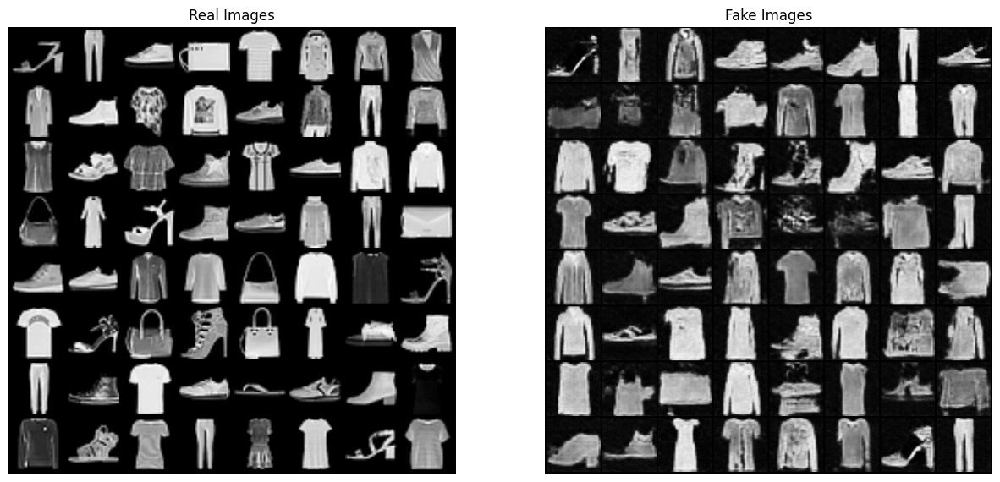

In [16]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(g_dcgan_a1_losses,label="G")
plt.plot(d_dcgan_a1_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()


# Real Images
real_batch = next(iter(train_loader))

plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Fake Images
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list_dgcan_a1[-1],(1,2,0)))
plt.show()

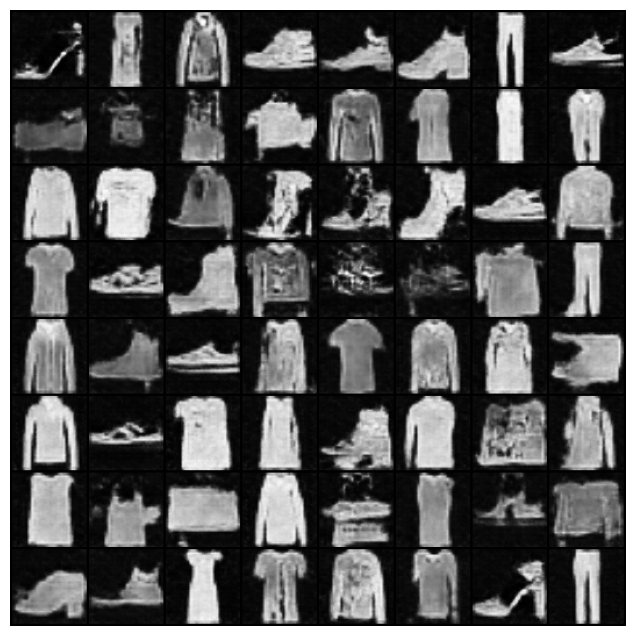

In [15]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list_dgcan_a1]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

## Additional functions

1.   loading the generator weights from a path save
2.   generating an image
3.   displaying the generated image.





In [12]:
def load_generator_weights(generator_model, path):
    generator_model.load_state_dict(torch.load(path))
    generator_model.eval()
    print(f"Generator weights loaded from {path}")
    return generator_model




## For loading weights and using trained generator

### **Note**: Must instantiate generator class and all imports above prior to running this block

In [13]:
def generate_and_show_image(generator, weight_path, nz, device):
    """
    Generates and displays an image using the provided generator model.

    Parameters:
    - generator: The generator network (an instance of your model class).
    - weight_path: Path to the generator weights (.pth file).
    - nz: The size of the noise vector (latent space dimension).
    - device: The device to run the model on (e.g., 'cpu' or 'cuda').
    """

    generator.to(device)
    generator.load_state_dict(torch.load(weight_path, map_location=device))
    generator.eval()


    noise = torch.randn(1, nz, 1, 1, device=device)
    with torch.no_grad():
        generated_image = generator(noise).cpu()

    def show_generated_image(img):
        img = (img + 1) / 2
        np_img = img.numpy()
        plt.imshow(np.transpose(np_img, (1, 2, 0)))
        plt.axis('off')
        plt.show()

    show_generated_image(generated_image[0])

## Example Usage

<ipython-input-31-3b06d6d0364e>:13: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  generator.load_state_dict(torch.load(weight_path, map_location=device))


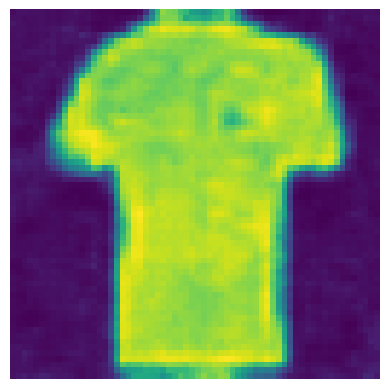

In [32]:
gen = Generator(ngpu=1)  # Adjust as needed
weight_path = './generator_weights_a1_dgcan.pth'
nz = 100
device = 'cuda' if torch.cuda.is_available() else 'cpu'
generate_and_show_image(gen, weight_path, nz, device)

## WGAN (with weight clipping)

### Generator

In [55]:
import torch.nn as nn

class Generator_WGAN(nn.Module):
    def __init__(self, nz, ngf, nc):
        super(Generator_WGAN, self).__init__()
        self.main = nn.Sequential(
            nn.ConvTranspose2d(nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            nn.ConvTranspose2d(ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            nn.ConvTranspose2d(ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
        )

    def forward(self, input):
        return self.main(input)

### Discriminator (critic)

In [56]:
class Critic_WGAN(nn.Module):
    def __init__(self, ndf, nc):
        super(Critic_WGAN, self).__init__()
        self.main = nn.Sequential(
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),

        )

    def forward(self, input):
        return self.main(input).view(-1)


In [57]:
device = torch.device("cuda:0" if (torch.cuda.is_available() ) else "cpu")

WGAN_G = Generator_WGAN(nz, ngf, nc).to(device)
WGAN_G.apply(weights_init)

critic = Critic_WGAN(ndf, nc).to(device)
critic.apply(weights_init)


print(WGAN_G)
print(critic)

Generator_WGAN(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 1, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
 

## Additional Pre-Train Setup

In [58]:
save_path_a1_wgan = "./generator_weights_a1_wgan.pth"
img_list_wgan_a1 = []
G_WGAN_losses = []
C_WGAN_losses = []
iters = 0

num_epochs = 5
n_critic = 5
weight_clip_value = 0.01

fixed_noise = torch.randn(64, nz, 1, 1, device=device)

lr = 0.0002

optimizerC_WGAN = torch.optim.RMSprop(critic.parameters(), lr=lr)
optimizerG_WGAN = torch.optim.RMSprop(WGAN_G.parameters(), lr=lr)

## Training

In [59]:
# Training Loop for WGAN
print("Starting Training Loop...")
for epoch in range(num_epochs):
    for i, data in enumerate(train_loader, 0):

        for _ in range(n_critic):
            critic.zero_grad()
            real_data = data[0].to(device)
            batch_size = real_data.size(0)

            real_output = critic(real_data).view(-1)
            critic_real_loss = -torch.mean(real_output)

            noise = torch.randn(batch_size, nz, 1, 1, device=device)

            fake_data = WGAN_G(noise)

            fake_output = critic(fake_data.detach()).view(-1)
            critic_fake_loss = torch.mean(fake_output)

            critic_loss = critic_real_loss + critic_fake_loss
            critic_loss.backward()
            optimizerC_WGAN.step()

            for p in critic.parameters():
                p.data.clamp_(-weight_clip_value, weight_clip_value)

        WGAN_G.zero_grad()
        noise = torch.randn(batch_size, nz, 1, 1, device=device)
        fake_data = WGAN_G(noise)

        fake_output = critic(fake_data).view(-1)
        generator_loss = -torch.mean(fake_output)

        generator_loss.backward()
        optimizerG_WGAN.step()

        G_WGAN_losses.append(generator_loss.item())
        C_WGAN_losses.append(critic_loss.item())

        if i % 50 == 0:
            print(f'[{epoch}/{num_epochs}][{i}/{len(train_loader)}]\t'
                  f'Loss_Critic: {critic_loss.item():.4f}\t'
                  f'Loss_Generator: {generator_loss.item():.4f}')

        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(train_loader)-1)):
            with torch.no_grad():
                fake = WGAN_G(fixed_noise).detach().cpu()
            img_list_wgan_a1.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1


torch.save(WGAN_G.state_dict(), save_path_a1_wgan)
print(f"Generator weights saved to {save_path_a1_wgan}")


Starting Training Loop...
[0/5][0/547]	Loss_Critic: -0.1818	Loss_Generator: 0.1030
[0/5][50/547]	Loss_Critic: -0.6502	Loss_Generator: 0.5004
[0/5][100/547]	Loss_Critic: -0.9767	Loss_Generator: 0.5816
[0/5][150/547]	Loss_Critic: -1.0572	Loss_Generator: 0.6000
[0/5][200/547]	Loss_Critic: -1.0980	Loss_Generator: 0.5800
[0/5][250/547]	Loss_Critic: -0.9888	Loss_Generator: 0.6084
[0/5][300/547]	Loss_Critic: -1.0529	Loss_Generator: 0.5014
[0/5][350/547]	Loss_Critic: -0.8647	Loss_Generator: 0.5674
[0/5][400/547]	Loss_Critic: -1.0150	Loss_Generator: 0.4218
[0/5][450/547]	Loss_Critic: -1.0705	Loss_Generator: 0.5303
[0/5][500/547]	Loss_Critic: -0.8797	Loss_Generator: 0.6077
[1/5][0/547]	Loss_Critic: -1.0370	Loss_Generator: 0.4615
[1/5][50/547]	Loss_Critic: -1.1219	Loss_Generator: 0.5296
[1/5][100/547]	Loss_Critic: -1.0157	Loss_Generator: 0.5835
[1/5][150/547]	Loss_Critic: -0.9135	Loss_Generator: 0.3115
[1/5][200/547]	Loss_Critic: -0.8726	Loss_Generator: 0.5968
[1/5][250/547]	Loss_Critic: -0.9991	

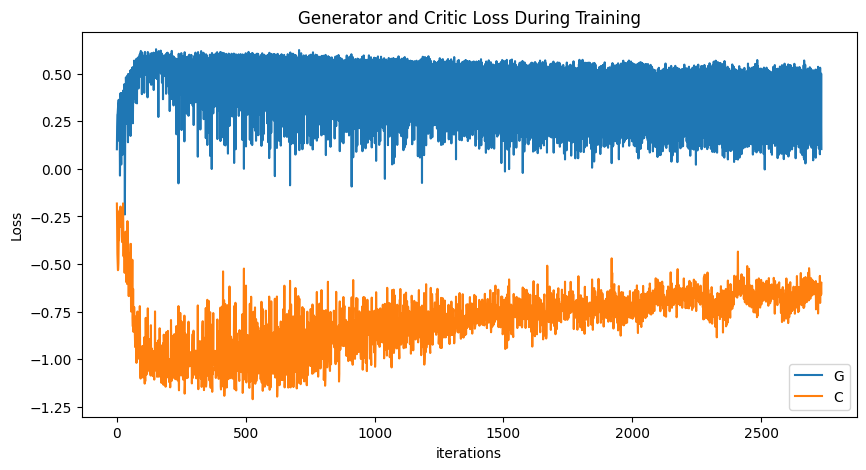

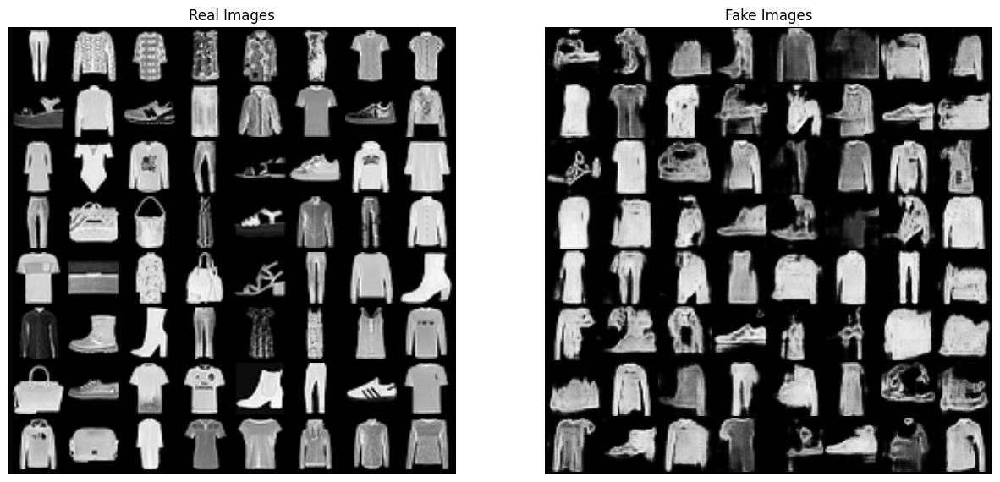

In [60]:
plt.figure(figsize=(10,5))
plt.title("Generator and Critic Loss During Training")
plt.plot(G_WGAN_losses,label="G")
plt.plot(C_WGAN_losses,label="C")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()


# Real Images
real_batch = next(iter(train_loader))
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Fake Images
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list_wgan_a1[-1],(1,2,0)))
plt.show()

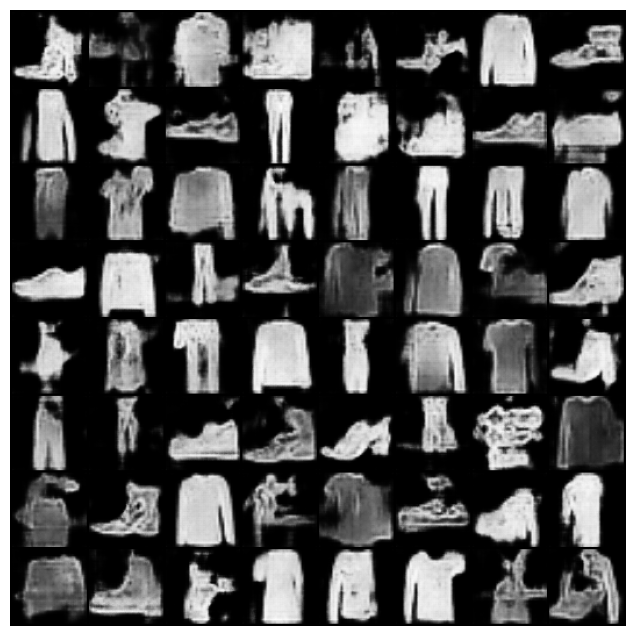

In [62]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list_wgan_a1]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

<ipython-input-31-3b06d6d0364e>:13: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  generator.load_state_dict(torch.load(weight_path, map_location=device))


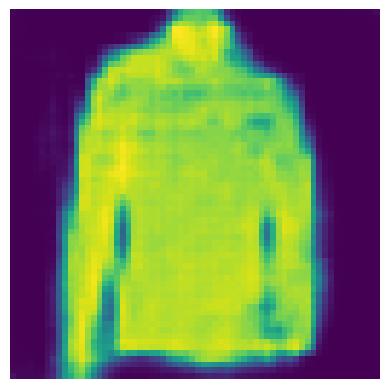

In [77]:
gen = Generator_WGAN(nz, ngf, nc)  # Adjust as needed
weight_path = './generator_weights_a1_wgan.pth'
nz = 100
device = 'cuda' if torch.cuda.is_available() else 'cpu'

generate_and_show_image(gen, weight_path, nz, device)

## WGAN-GP (with gradient penalty)

### Function to compute gradient penalty

In [454]:
def compute_gradient_penalty(critic, real_data, fake_data, lambda_gp=10):
    alpha = torch.rand(real_data.size(0), 1, 1, 1, device=real_data.device)
    interpolates = alpha * real_data + (1 - alpha) * fake_data
    interpolates.requires_grad_(True)

    critic_interpolates = critic(interpolates).view(-1)

    gradients = torch.autograd.grad(
        outputs=critic_interpolates,
        inputs=interpolates,
        grad_outputs=torch.ones_like(critic_interpolates),
        create_graph=True,
        retain_graph=True,
        only_inputs=True,
    )[0]

    gradients = gradients.view(gradients.size(0), -1)
    gradient_penalty = ((gradients.norm(2, dim=1) - 1) ** 2).mean() * lambda_gp
    return gradient_penalty


### Same architecture as before, but the critic uses layernorm rather than batchnorm for gradient penalty case

In [455]:
class Critic_WGAN_GP(nn.Module):
    def __init__(self, ndf, nc):
        super(Critic_WGAN_GP, self).__init__()
        self.main = nn.Sequential(
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            LayerNorm2d(ndf * 2),

            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            LayerNorm2d(ndf * 4),

            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            LayerNorm2d(ndf * 8),

            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
        )

    def forward(self, input):
        return self.main(input).view(-1)

class LayerNorm2d(nn.Module):
    """Applies LayerNorm over each channel in a 4D input tensor."""
    def __init__(self, num_features, eps=1e-5):
        super(LayerNorm2d, self).__init__()
        self.num_features = num_features
        self.eps = eps
        self.weight = nn.Parameter(torch.ones(num_features))
        self.bias = nn.Parameter(torch.zeros(num_features))

    def forward(self, x):
        b, c, h, w = x.size()
        x = x.view(b, c, -1)

        mean = x.mean(dim=-1, keepdim=True)
        var = x.var(dim=-1, keepdim=True, unbiased=False)

        x = (x - mean) / torch.sqrt(var + self.eps)

        x = x.view(b, c, h, w)
        return self.weight[:, None, None] * x + self.bias[:, None, None]

### Additional Pre-Train Setup, Reusing previously defined WGAN Generator architecture


In [457]:
device = torch.device("cuda:0" if (torch.cuda.is_available() ) else "cpu")

WGAN_GP_G = Generator_WGAN(nz, ngf, nc).to(device)
WGAN_GP_G.apply(weights_init)

critic_GP = Critic_WGAN_GP(ndf, nc).to(device)
critic_GP.apply(weights_init)

save_path_a1_wgan_gp = "./generator_weights_a1_wgan_gp.pth"
img_list_wgan_gp_a1 = []
G_WGAN_GP_losses = []
C_WGAN_GP_losses = []
iters = 0

num_epochs = 5
n_critic = 5

fixed_noise = torch.randn(64, nz, 1, 1, device=device)

lr = 0.0001

optimizerC_WGAN_GP = optim.Adam(critic_GP.parameters(), lr=lr, betas=(0.0, 0.9))

optimizerG_WGAN_GP = optim.Adam(WGAN_GP_G.parameters(), lr=lr, betas=(0.0, 0.9))


print(WGAN_GP_G)
print(critic_GP)

lambda_gp = 10


Generator_WGAN(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 1, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
 

## Training

In [458]:
# Adjust the training loop
print("Starting Training Loop...")
for epoch in range(num_epochs):
    for i, data in enumerate(train_loader, 0):
        for _ in range(n_critic):
            critic_GP.zero_grad()
            real_data = data[0].to(device)
            batch_size = real_data.size(0)
            real_output = critic_GP(real_data).view(-1)
            critic_real_loss = -torch.mean(real_output)
            noise = torch.randn(batch_size, nz, 1, 1, device=device)
            fake_data = WGAN_GP_G(noise)
            fake_output = critic_GP(fake_data.detach()).view(-1)
            critic_fake_loss = torch.mean(fake_output)
            gradient_penalty = compute_gradient_penalty(critic_GP, real_data, fake_data, lambda_gp)
            critic_loss = critic_real_loss + critic_fake_loss + gradient_penalty
            critic_loss.backward()
            optimizerC_WGAN_GP.step()


        WGAN_GP_G.zero_grad()

        noise = torch.randn(batch_size, nz, 1, 1, device=device)
        fake_data = WGAN_GP_G(noise)
        fake_output = critic_GP(fake_data).view(-1)
        generator_loss = -torch.mean(fake_output)

        generator_loss.backward()
        optimizerG_WGAN_GP.step()

        G_WGAN_GP_losses.append(generator_loss.item())
        C_WGAN_GP_losses.append(critic_loss.item())

        if i % 50 == 0:
            print(f'[{epoch}/{num_epochs}][{i}/{len(train_loader)}] '
                  f'Loss_Critic: {critic_loss.item():.4f} '
                  f'Loss_Generator: {generator_loss.item():.4f}')

        if (iters % 500 == 0) or ((epoch == num_epochs - 1) and (i == len(train_loader) - 1)):
            with torch.no_grad():
                fake = WGAN_GP_G(fixed_noise).detach().cpu()
            img_list_wgan_gp_a1.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

torch.save(WGAN_GP_G.state_dict(), save_path_a1_wgan_gp)
print(f"Generator weights saved to {save_path_a1_wgan_gp}")

Starting Training Loop...
[0/5][0/547] Loss_Critic: 723.1301 Loss_Generator: 0.3036
[0/5][50/547] Loss_Critic: -21.2374 Loss_Generator: 13.7405
[0/5][100/547] Loss_Critic: -20.4095 Loss_Generator: 14.0673
[0/5][150/547] Loss_Critic: -19.8833 Loss_Generator: 13.7755
[0/5][200/547] Loss_Critic: -20.4631 Loss_Generator: 18.2248
[0/5][250/547] Loss_Critic: -20.7105 Loss_Generator: 17.8033
[0/5][300/547] Loss_Critic: -19.3479 Loss_Generator: 23.0152
[0/5][350/547] Loss_Critic: -17.8925 Loss_Generator: 23.0649
[0/5][400/547] Loss_Critic: -17.7451 Loss_Generator: 24.3928
[0/5][450/547] Loss_Critic: -17.6259 Loss_Generator: 24.8765
[0/5][500/547] Loss_Critic: -15.9409 Loss_Generator: 33.1579
[1/5][0/547] Loss_Critic: -13.9327 Loss_Generator: 32.2787
[1/5][50/547] Loss_Critic: -14.7602 Loss_Generator: 31.5966
[1/5][100/547] Loss_Critic: -16.2486 Loss_Generator: 29.7058
[1/5][150/547] Loss_Critic: -16.2229 Loss_Generator: 28.9171
[1/5][200/547] Loss_Critic: -14.2299 Loss_Generator: 37.2181
[1/5]

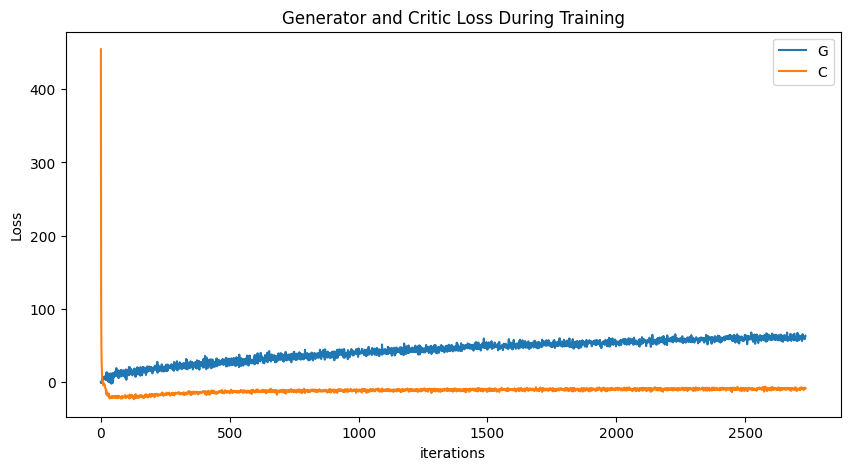

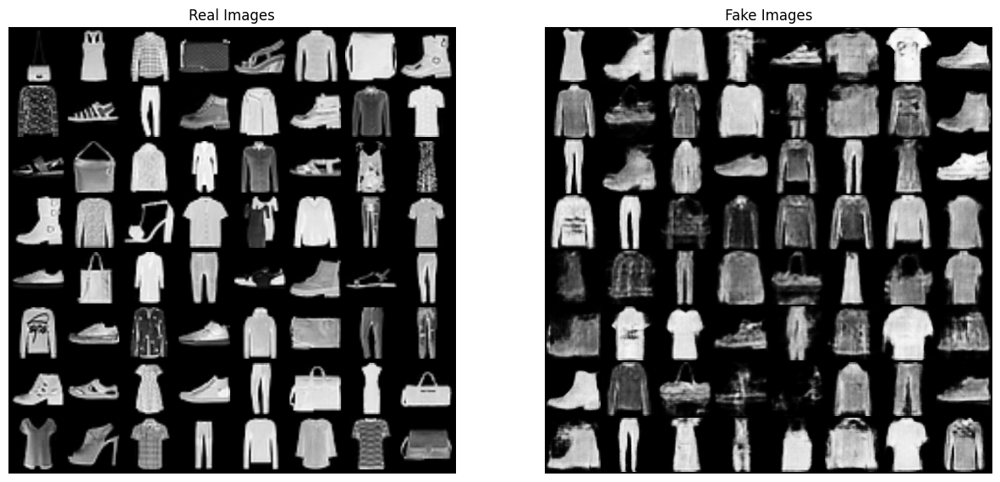

In [48]:
plt.figure(figsize=(10,5))
plt.title("Generator and Critic Loss During Training")
plt.plot(G_WGAN_GP_losses,label="G")
plt.plot(C_WGAN_GP_losses,label="C")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()


# Real Images
real_batch = next(iter(train_loader))
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Fake images
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list_wgan_gp_a1[-1],(1,2,0)))
plt.show()

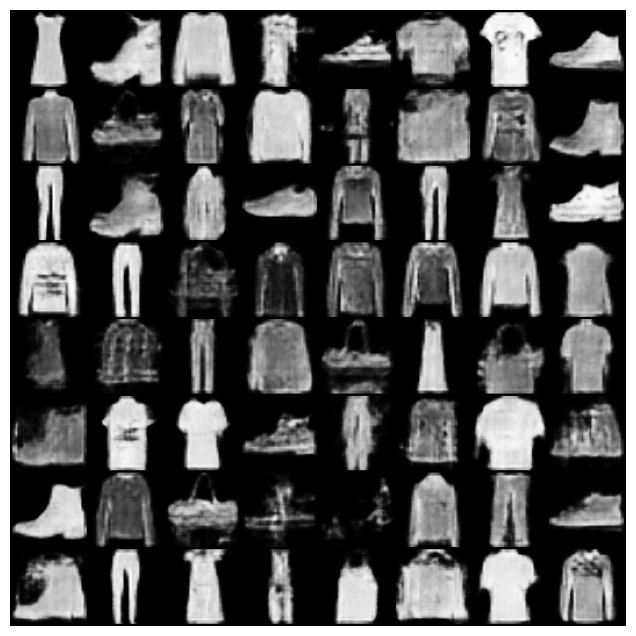

In [49]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list_wgan_gp_a1]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)
HTML(ani.to_jshtml())

<ipython-input-13-3b06d6d0364e>:13: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  generator.load_state_dict(torch.load(weight_path, map_location=device))


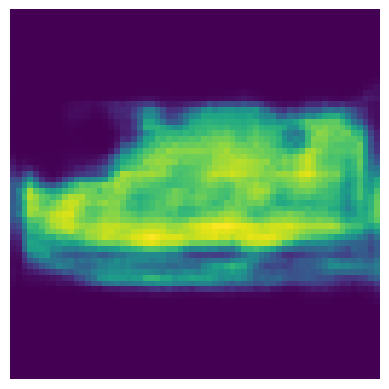

In [72]:
gen = Generator_WGAN(nz, ngf, nc)  # Adjust as needec
weight_path = './generator_weights_a1_wgan_gp.pth'
nz = 100
device = 'cuda' if torch.cuda.is_available() else 'cpu'
generate_and_show_image(gen, weight_path, nz, device)

## Approach Comparison:
### Architecture 1 Generator and Discriminator / Critic Loss

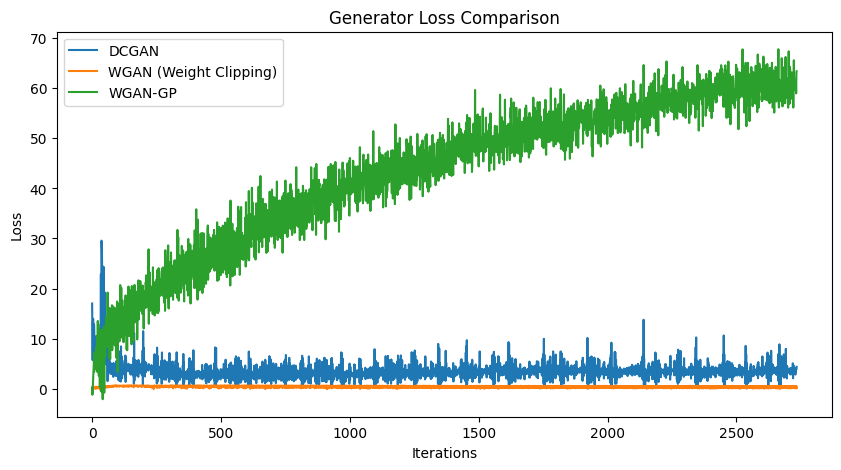

In [61]:
plt.figure(figsize=(10, 5))
plt.title("Generator Loss Comparison")
plt.plot(g_dcgan_a1_losses, label="DCGAN")
plt.plot(G_WGAN_losses, label="WGAN (Weight Clipping)")
plt.plot(G_WGAN_GP_losses, label="WGAN-GP")
plt.xlabel("Iterations")
plt.ylabel("Loss")

#plt.ylim(-20, 20)
plt.legend()
plt.show()

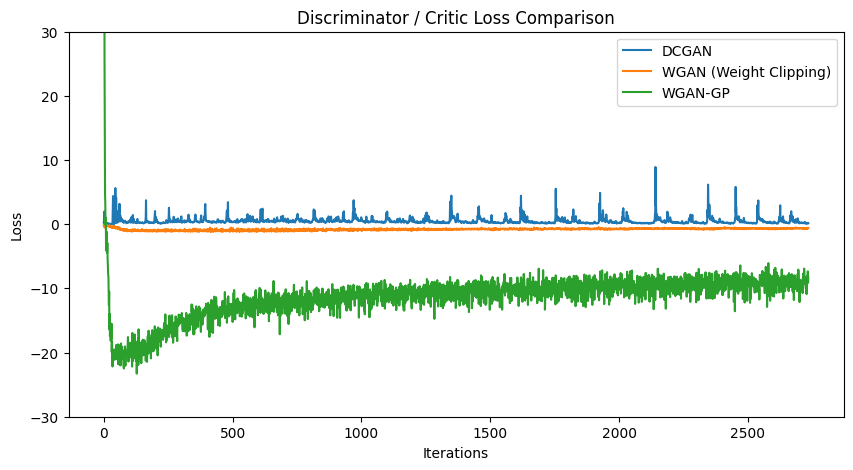

In [63]:
plt.figure(figsize=(10, 5))
plt.title("Discriminator / Critic Loss Comparison")
plt.plot(d_dcgan_a1_losses, label="DCGAN")
plt.plot(C_WGAN_losses, label="WGAN (Weight Clipping)")
plt.plot(C_WGAN_GP_losses, label="WGAN-GP")
plt.xlabel("Iterations")
plt.ylabel("Loss")

plt.ylim(-30, 30)
plt.legend()
plt.show()

# Architecture 2
### Base filter count for both Generator and Discriminator becomes 32
[
nonlinG: ReLU,
nonlinD: ReLU,
depthG: 4,
depthD: 4,
batchnormG: True,
batchnormD: True,
FilterG: 32,
filterD: 32
]

In [94]:
# Batch size during training
batch_size = 128

image_size = 64

nc = 1

nz = 100

ngf = 32

ndf = 32

num_epochs = 5

lr = 0.0002

beta1 = 0.5

ngpu = 1

In [95]:
device = torch.device("cuda:0" if (torch.cuda.is_available() ) else "cpu")

netG_a2 = Generator(ngpu).to(device)
netG_a2.apply(weights_init)


netD_a2 = Discriminator(ngpu).to(device)
netD_a2.apply(weights_init)

print(netD_a2)
print(netG_a2)

Discriminator(
  (main): Sequential(
    (0): Conv2d(1, 32, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(32, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(256, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)
Generator(
  (main): Sequential(


### Additional Pre-train Setup

In [96]:
criterion = nn.BCELoss()

fixed_noise = torch.randn(64, nz, 1, 1, device=device)

real_label = 1.
fake_label = 0.

optimizerD_a2 = optim.Adam(netD_a2.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG_a2 = optim.Adam(netG_a2.parameters(), lr=lr, betas=(beta1, 0.999))

## Training

In [97]:
save_path_a2_dcgan = "./generator_weights_a2_dgcan.pth"
img_list_dgcan_a2 = []
g_dcgan_a2_losses = []
d_dcgan_a2_losses = []
iters = 0

# Training loop
print("Starting Training Loop...")
for epoch in range(num_epochs):
    for i, data in enumerate(train_loader, 0):
        netD_a2.zero_grad()
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        output = netD_a2(real_cpu).view(-1)
        errD_real = criterion(output, label)
        errD_real.backward()
        D_x = output.mean().item()

        noise = torch.randn(b_size, nz, 1, 1, device=device)
        fake = netG_a2(noise)
        label.fill_(fake_label)
        output = netD_a2(fake.detach()).view(-1)
        errD_fake = criterion(output, label)
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        errD = errD_real + errD_fake
        optimizerD_a2.step()

        netG_a2.zero_grad()
        label.fill_(real_label)
        output = netD_a2(fake).view(-1)
        errG = criterion(output, label)
        errG.backward()
        D_G_z2 = output.mean().item()
        optimizerG_a2.step()

        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(train_loader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        g_dcgan_a2_losses.append(errG.item())
        d_dcgan_a2_losses.append(errD.item())

        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(train_loader)-1)):
            with torch.no_grad():
                fake = netG_a2(fixed_noise).detach().cpu()
            img_list_dgcan_a2.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

torch.save(netG_a2.state_dict(), save_path_a2_dcgan)
print(f"Generator weights saved to {save_path_a2_dcgan}")

Starting Training Loop...
[0/5][0/547]	Loss_D: 1.5721	Loss_G: 2.2539	D(x): 0.6624	D(G(z)): 0.6286 / 0.1285
[0/5][50/547]	Loss_D: 0.0699	Loss_G: 6.6263	D(x): 0.9768	D(G(z)): 0.0250 / 0.0015
[0/5][100/547]	Loss_D: 0.0109	Loss_G: 7.1629	D(x): 0.9967	D(G(z)): 0.0075 / 0.0009
[0/5][150/547]	Loss_D: 0.0156	Loss_G: 7.1288	D(x): 0.9934	D(G(z)): 0.0045 / 0.0009
[0/5][200/547]	Loss_D: 0.0034	Loss_G: 7.1554	D(x): 0.9992	D(G(z)): 0.0026 / 0.0008
[0/5][250/547]	Loss_D: 0.0023	Loss_G: 7.2840	D(x): 0.9996	D(G(z)): 0.0018 / 0.0007
[0/5][300/547]	Loss_D: 0.0020	Loss_G: 7.5988	D(x): 0.9995	D(G(z)): 0.0015 / 0.0005
[0/5][350/547]	Loss_D: 0.0016	Loss_G: 7.5353	D(x): 0.9996	D(G(z)): 0.0012 / 0.0006
[0/5][400/547]	Loss_D: 0.0007	Loss_G: 8.1230	D(x): 0.9998	D(G(z)): 0.0005 / 0.0003
[0/5][450/547]	Loss_D: 0.0006	Loss_G: 7.9450	D(x): 0.9999	D(G(z)): 0.0005 / 0.0004
[0/5][500/547]	Loss_D: 0.0009	Loss_G: 7.8942	D(x): 0.9998	D(G(z)): 0.0007 / 0.0004
[1/5][0/547]	Loss_D: 0.0005	Loss_G: 8.2276	D(x): 0.9999	D(G(z)):

## DCGAN Architecture 2 Images and Loss

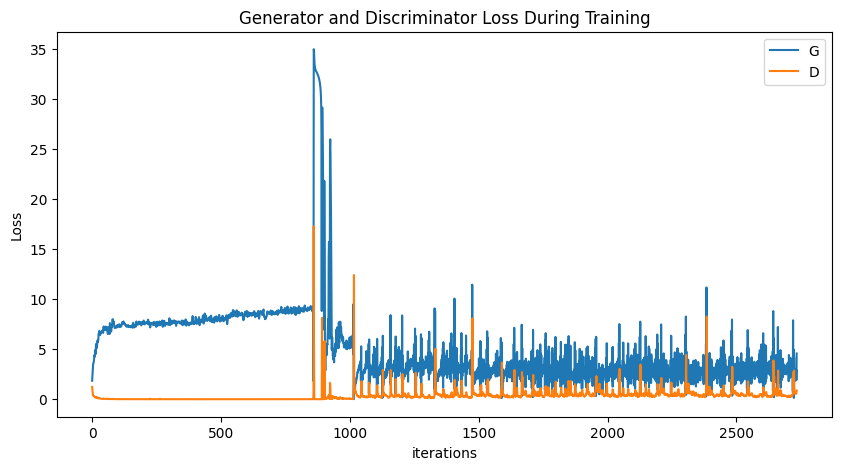

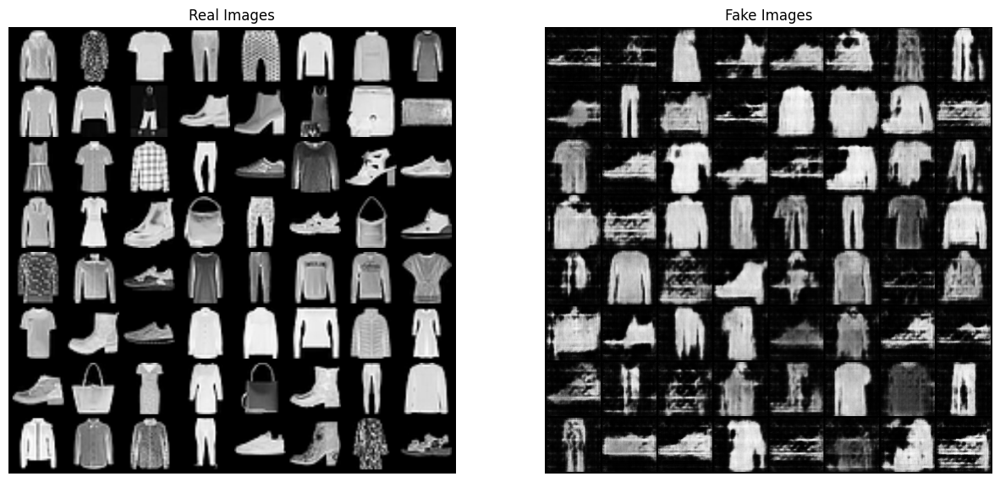

In [89]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(g_dcgan_a2_losses,label="G")
plt.plot(d_dcgan_a2_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()


# Real images
real_batch = next(iter(train_loader))

plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Fake images
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list_dgcan_a2[-1],(1,2,0)))
plt.show()

In [ ]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list_dgcan_a2]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

## Example Image

<ipython-input-13-3b06d6d0364e>:13: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  generator.load_state_dict(torch.load(weight_path, map_location=device))


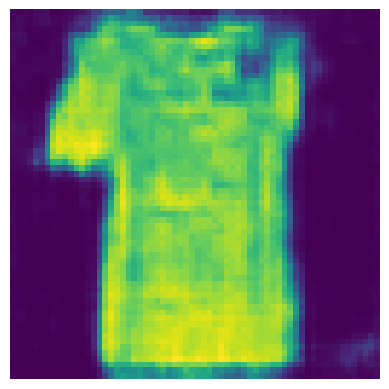

In [115]:
gen = Generator(ngpu=1)  # Adjust as needed
weight_path = './generator_weights_a2_dgcan.pth'
nz = 100
device = 'cuda' if torch.cuda.is_available() else 'cpu'
generate_and_show_image(gen, weight_path, nz, device)

## WGAN with weight clipping - Architecture 2

### Create Models

In [126]:
device = torch.device("cuda:0" if (torch.cuda.is_available() ) else "cpu")

WGAN_G_a2 = Generator_WGAN(nz, ngf, nc).to(device)
WGAN_G_a2.apply(weights_init)

critic_a2 = Critic_WGAN(ndf, nc).to(device)
critic_a2.apply(weights_init)


print(WGAN_G_a2)
print(critic_a2)

Generator_WGAN(
  (main): Sequential(
    (0): ConvTranspose2d(100, 256, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(64, 32, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(32, 1, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )


## Additional Pre-train Setup

In [127]:
save_path_a2_wgan = "./generator_weights_a2_wgan.pth"
img_list_wgan_a2 = []
G_WGAN_losses_a2 = []
C_WGAN_losses_a2 = []  # Critic losses (formerly D_losses)
iters = 0

num_epochs = 5
n_critic = 5
weight_clip_value = 0.01

fixed_noise = torch.randn(64, nz, 1, 1, device=device)

lr = 0.0002

optimizerC_WGAN_a2 = torch.optim.RMSprop(critic_a2.parameters(), lr=lr)
optimizerG_WGAN_a2 = torch.optim.RMSprop(WGAN_G_a2.parameters(), lr=lr)

## Training

In [128]:
# Training Loop for WGAN
print("Starting Training Loop...")
for epoch in range(num_epochs):
    for i, data in enumerate(train_loader, 0):
        for _ in range(n_critic):
            critic_a2.zero_grad()
            real_data = data[0].to(device)
            batch_size = real_data.size(0)
            real_output = critic_a2(real_data).view(-1)
            critic_real_loss = -torch.mean(real_output)

            noise = torch.randn(batch_size, nz, 1, 1, device=device)

            fake_data = WGAN_G_a2(noise)

            fake_output = critic_a2(fake_data.detach()).view(-1)
            critic_fake_loss = torch.mean(fake_output)

            critic_loss = critic_real_loss + critic_fake_loss
            critic_loss.backward()
            optimizerC_WGAN_a2.step()

            for p in critic_a2.parameters():
                p.data.clamp_(-weight_clip_value, weight_clip_value)

        WGAN_G_a2.zero_grad()

        noise = torch.randn(batch_size, nz, 1, 1, device=device)
        fake_data = WGAN_G_a2(noise)

        fake_output = critic_a2(fake_data).view(-1)
        generator_loss = -torch.mean(fake_output)

        generator_loss.backward()
        optimizerG_WGAN_a2.step()

        G_WGAN_losses_a2.append(generator_loss.item())
        C_WGAN_losses_a2.append(critic_loss.item())

        if i % 50 == 0:
            print(f'[{epoch}/{num_epochs}][{i}/{len(train_loader)}]\t'
                  f'Loss_Critic: {critic_loss.item():.4f}\t'
                  f'Loss_Generator: {generator_loss.item():.4f}')

        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(train_loader)-1)):
            with torch.no_grad():
                fake = WGAN_G_a2(fixed_noise).detach().cpu()
            img_list_wgan_a2.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1


torch.save(WGAN_G_a2.state_dict(), save_path_a2_wgan)
print(f"Generator weights saved to {save_path_a2_wgan}")


Starting Training Loop...
[0/5][0/547]	Loss_Critic: -0.0357	Loss_Generator: 0.0097
[0/5][50/547]	Loss_Critic: -0.1838	Loss_Generator: -0.0361
[0/5][100/547]	Loss_Critic: -0.2978	Loss_Generator: 0.2382
[0/5][150/547]	Loss_Critic: -0.3960	Loss_Generator: 0.1961
[0/5][200/547]	Loss_Critic: -0.3396	Loss_Generator: 0.2420
[0/5][250/547]	Loss_Critic: -0.3618	Loss_Generator: 0.2645
[0/5][300/547]	Loss_Critic: -0.3274	Loss_Generator: 0.1336
[0/5][350/547]	Loss_Critic: -0.3632	Loss_Generator: 0.2498
[0/5][400/547]	Loss_Critic: -0.3665	Loss_Generator: 0.2455
[0/5][450/547]	Loss_Critic: -0.3426	Loss_Generator: 0.0874
[0/5][500/547]	Loss_Critic: -0.3527	Loss_Generator: 0.2179
[1/5][0/547]	Loss_Critic: -0.2692	Loss_Generator: 0.2357
[1/5][50/547]	Loss_Critic: -0.3270	Loss_Generator: 0.2263
[1/5][100/547]	Loss_Critic: -0.2812	Loss_Generator: 0.0902
[1/5][150/547]	Loss_Critic: -0.2961	Loss_Generator: 0.0672
[1/5][200/547]	Loss_Critic: -0.2712	Loss_Generator: 0.0833
[1/5][250/547]	Loss_Critic: -0.2726

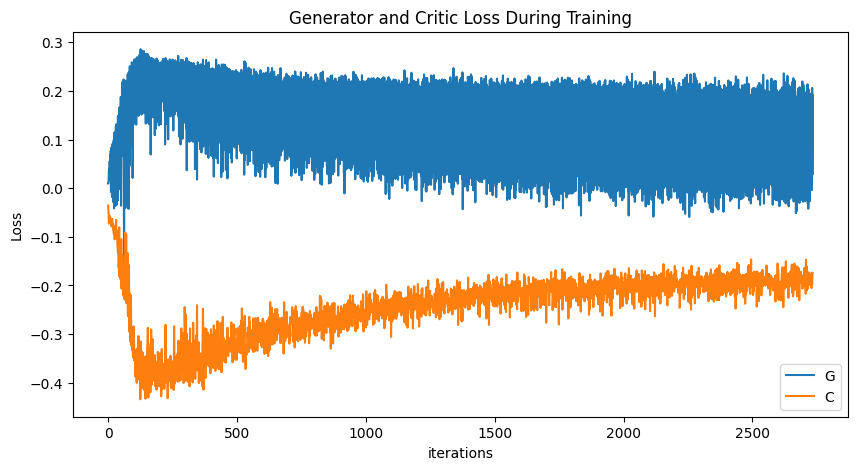

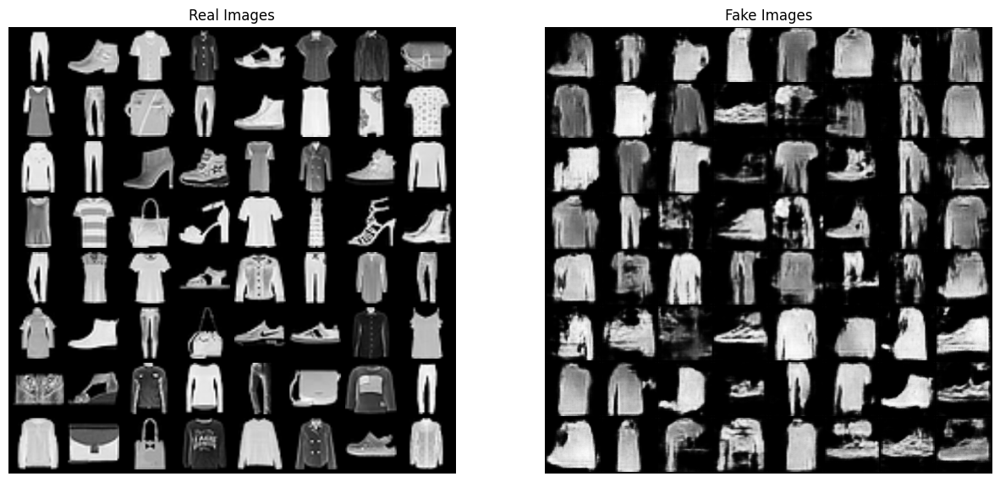

In [129]:
plt.figure(figsize=(10,5))
plt.title("Generator and Critic Loss During Training")
plt.plot(G_WGAN_losses_a2,label="G")
plt.plot(C_WGAN_losses_a2,label="C")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()


# Real images
real_batch = next(iter(train_loader))

plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Fake images
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list_wgan_a2[-1],(1,2,0)))
plt.show()

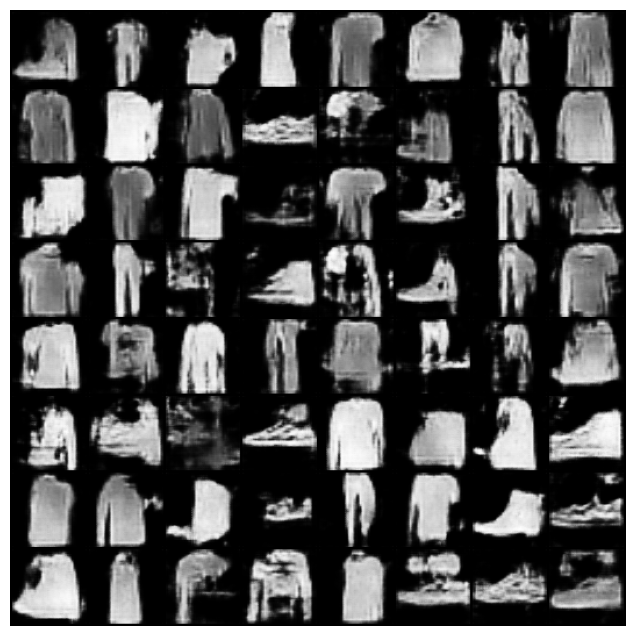

In [130]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list_wgan_a2]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

<ipython-input-13-3b06d6d0364e>:13: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  generator.load_state_dict(torch.load(weight_path, map_location=device))


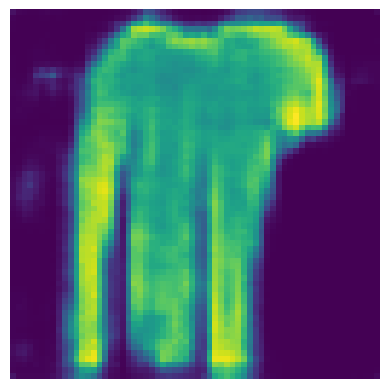

In [138]:
gen = Generator_WGAN(nz, ngf, nc)
weight_path = './generator_weights_a2_wgan.pth'
nz = 100
device = 'cuda' if torch.cuda.is_available() else 'cpu'

generate_and_show_image(gen, weight_path, nz, device)

## WGAN-GP - Architecture 2

In [142]:
device = torch.device("cuda:0" if (torch.cuda.is_available() ) else "cpu")

WGAN_GP_G_a2 = Generator_WGAN(nz, ngf, nc).to(device)
WGAN_GP_G_a2.apply(weights_init)

critic_GP_a2 = Critic_WGAN_GP(ndf, nc).to(device)
critic_GP_a2.apply(weights_init)

save_path_a2_wgan_gp = "./generator_weights_a2_wgan_gp.pth"
img_list_wgan_gp_a2 = []
G_WGAN_GP_losses_a2 = []
C_WGAN_GP_losses_a2 = []
iters = 0

num_epochs = 5
n_critic = 5
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

lr = 0.0001

optimizerC_WGAN_GP_a2 = optim.Adam(critic_GP_a2.parameters(), lr=lr, betas=(0.0, 0.9))

optimizerG_WGAN_GP_a2 = optim.Adam(WGAN_GP_G_a2.parameters(), lr=lr, betas=(0.0, 0.9))


print(WGAN_GP_G_a2)
print(critic_GP_a2)

lambda_gp = 10


Generator_WGAN(
  (main): Sequential(
    (0): ConvTranspose2d(100, 256, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(64, 32, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(32, 1, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )


## Training

In [143]:
print("Starting Training Loop...")
for epoch in range(num_epochs):
    for i, data in enumerate(train_loader, 0):
        for _ in range(n_critic):
            critic_GP_a2.zero_grad()

            real_data = data[0].to(device)
            batch_size = real_data.size(0)

            real_output = critic_GP_a2(real_data).view(-1)
            critic_real_loss = -torch.mean(real_output)

            noise = torch.randn(batch_size, nz, 1, 1, device=device)
            fake_data = WGAN_GP_G_a2(noise)

            fake_output = critic_GP_a2(fake_data.detach()).view(-1)
            critic_fake_loss = torch.mean(fake_output)

            gradient_penalty = compute_gradient_penalty(critic_GP_a2, real_data, fake_data, lambda_gp)

            critic_loss = critic_real_loss + critic_fake_loss + gradient_penalty
            critic_loss.backward()
            optimizerC_WGAN_GP_a2.step()

        WGAN_GP_G_a2.zero_grad()

        noise = torch.randn(batch_size, nz, 1, 1, device=device)
        fake_data = WGAN_GP_G_a2(noise)
        fake_output = critic_GP_a2(fake_data).view(-1)
        generator_loss = -torch.mean(fake_output)

        generator_loss.backward()
        optimizerG_WGAN_GP_a2.step()

        G_WGAN_GP_losses_a2.append(generator_loss.item())
        C_WGAN_GP_losses_a2.append(critic_loss.item())

        if i % 50 == 0:
            print(f'[{epoch}/{num_epochs}][{i}/{len(train_loader)}] '
                  f'Loss_Critic: {critic_loss.item():.4f} '
                  f'Loss_Generator: {generator_loss.item():.4f}')

        # Save images
        if (iters % 500 == 0) or ((epoch == num_epochs - 1) and (i == len(train_loader) - 1)):
            with torch.no_grad():
                fake = WGAN_GP_G_a2(fixed_noise).detach().cpu()
            img_list_wgan_gp_a2.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

# Save generator weights
torch.save(WGAN_GP_G_a2.state_dict(), save_path_a2_wgan_gp)
print(f"Generator weights saved to {save_path_a2_wgan_gp}")

Starting Training Loop...
[0/5][0/547] Loss_Critic: 523.8462 Loss_Generator: -0.1741
[0/5][50/547] Loss_Critic: -28.7023 Loss_Generator: 11.7327
[0/5][100/547] Loss_Critic: -36.8282 Loss_Generator: 11.3956
[0/5][150/547] Loss_Critic: -23.1564 Loss_Generator: 11.4117
[0/5][200/547] Loss_Critic: -22.4932 Loss_Generator: 2.1068
[0/5][250/547] Loss_Critic: -17.8997 Loss_Generator: 2.5415
[0/5][300/547] Loss_Critic: -19.1311 Loss_Generator: 10.2062
[0/5][350/547] Loss_Critic: -16.7265 Loss_Generator: 7.1987
[0/5][400/547] Loss_Critic: -16.9967 Loss_Generator: 10.3273
[0/5][450/547] Loss_Critic: -17.8833 Loss_Generator: 10.5691
[0/5][500/547] Loss_Critic: -15.7314 Loss_Generator: 11.6419
[1/5][0/547] Loss_Critic: -16.5036 Loss_Generator: 9.7048
[1/5][50/547] Loss_Critic: -15.2450 Loss_Generator: 14.4883
[1/5][100/547] Loss_Critic: -15.9522 Loss_Generator: 12.4549
[1/5][150/547] Loss_Critic: -15.9818 Loss_Generator: 15.6432
[1/5][200/547] Loss_Critic: -14.1772 Loss_Generator: 18.4141
[1/5][25

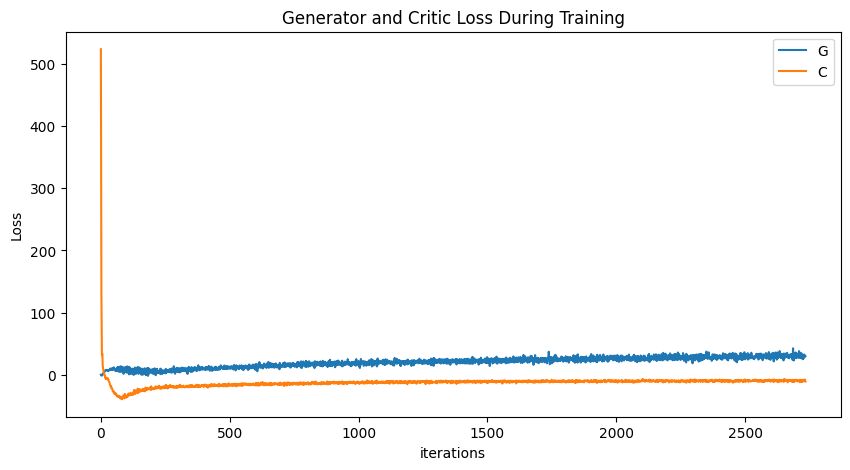

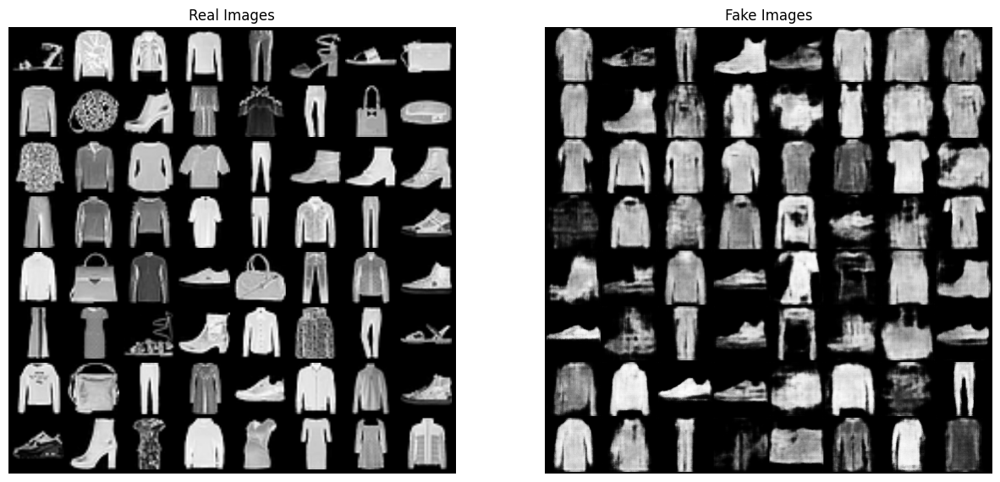

In [144]:
plt.figure(figsize=(10,5))
plt.title("Generator and Critic Loss During Training")
plt.plot(G_WGAN_GP_losses_a2,label="G")
plt.plot(C_WGAN_GP_losses_a2,label="C")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()


# real images
real_batch = next(iter(train_loader))

plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# fake images
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list_wgan_gp_a2[-1],(1,2,0)))
plt.show()

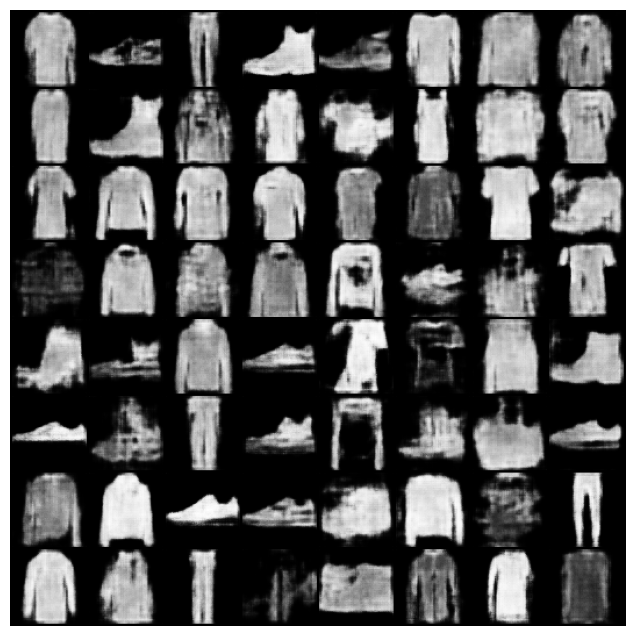

In [146]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list_wgan_gp_a2]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)
HTML(ani.to_jshtml())

<ipython-input-13-3b06d6d0364e>:13: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  generator.load_state_dict(torch.load(weight_path, map_location=device))


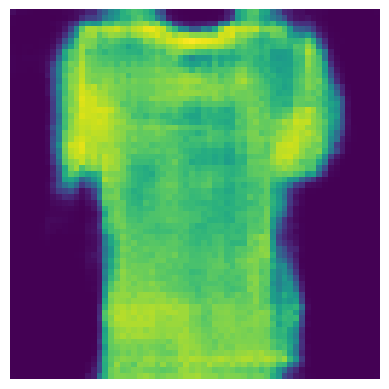

In [154]:
gen = Generator_WGAN(nz, ngf, nc)  # Adjust as needed
weight_path = './generator_weights_a2_wgan_gp.pth'
nz = 100
device = 'cuda' if torch.cuda.is_available() else 'cpu'
generate_and_show_image(gen, weight_path, nz, device)

## Approach Comparison:
### Architecture 1 Generator and Discriminator / Critic Loss

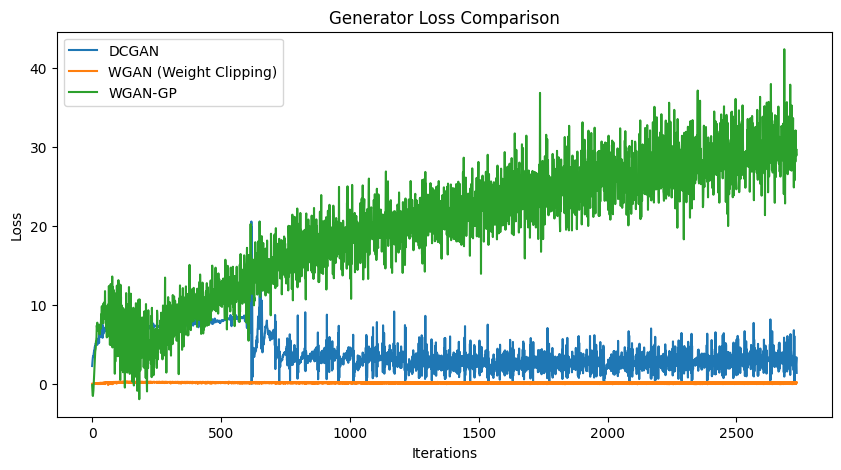

In [155]:
plt.figure(figsize=(10, 5))
plt.title("Generator Loss Comparison")
plt.plot(g_dcgan_a2_losses, label="DCGAN")
plt.plot(G_WGAN_losses_a2, label="WGAN (Weight Clipping)")
plt.plot(G_WGAN_GP_losses_a2, label="WGAN-GP")
plt.xlabel("Iterations")
plt.ylabel("Loss")

#plt.ylim(-20, 20)
plt.legend()
plt.show()

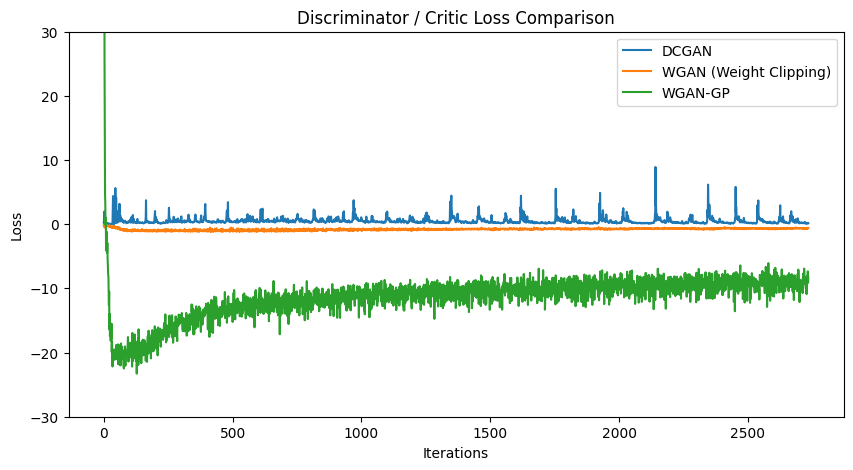

In [156]:
plt.figure(figsize=(10, 5))
plt.title("Discriminator / Critic Loss Comparison")
plt.plot(d_dcgan_a1_losses, label="DCGAN")
plt.plot(C_WGAN_losses, label="WGAN (Weight Clipping)")
plt.plot(C_WGAN_GP_losses, label="WGAN-GP")
plt.xlabel("Iterations")
plt.ylabel("Loss")

plt.ylim(-30, 30)
plt.legend()
plt.show()

From the results, it seems as though Architecture 1 with the larger base filter count for both the generator and the discriminator (64) performed better and generated more clear images that better represented the real distribution of sample images

# Generated vs Real images from better performing architecture

In [233]:
def sample_real_images(label, data_loader, num_images=6):

    real_images = []

    for imgs, lbls in data_loader:
        for img, lbl in zip(imgs, lbls):
            if lbl.item() == label:
                real_images.append(img.squeeze())
            if len(real_images) >= num_images:
                return real_images

    return real_images

### Reset Architecture Settings

In [234]:

batch_size = 128
image_size = 64
nc = 1
nz = 100
ngf = 64
ndf = 64
num_epochs = 5
lr = 0.0002
beta1 = 0.5
ngpu = 1

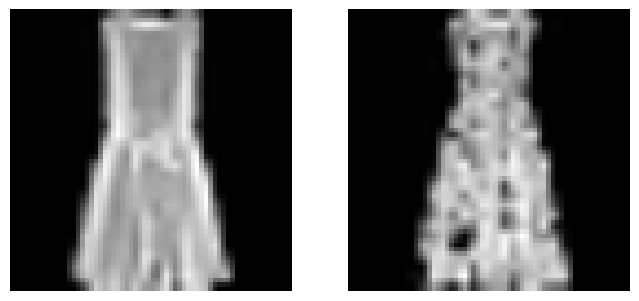

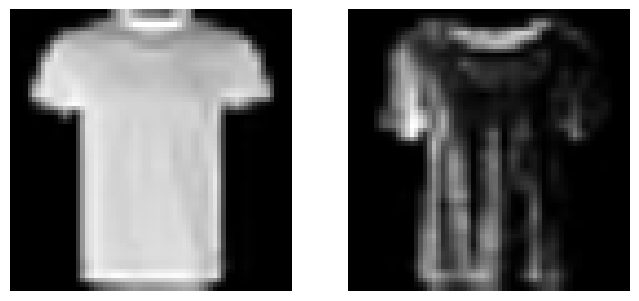

In [271]:
def display_real_images(images):
    fig, axes = plt.subplots(1, 2, figsize=(8, 4))

    for i in range(2):
        axes[i].imshow(images[i].squeeze(), cmap='gray')
        axes[i].axis('off')

    plt.show()


target_label = 0
target_label_2 = 3

real_images = sample_real_images(target_label, train_loader, num_images=2)
real_images_2= sample_real_images(target_label_2, train_loader, num_images=2)


display_real_images(real_images_2)

display_real_images(real_images)


## DCGAN Architecture 1

<ipython-input-13-3b06d6d0364e>:13: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  generator.load_state_dict(torch.load(weight_path, map_location=device))


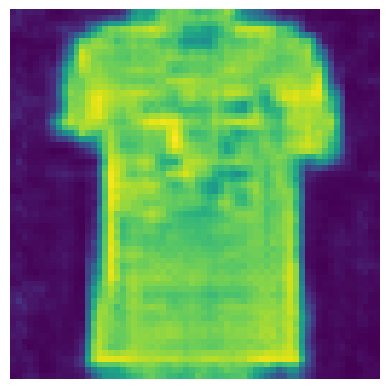

In [239]:
gen = Generator(ngpu=1)
weight_path = './generator_weights_a1_dgcan.pth'
nz = 100
device = 'cuda' if torch.cuda.is_available() else 'cpu'
generate_and_show_image(gen, weight_path, nz, device)


<ipython-input-13-3b06d6d0364e>:13: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  generator.load_state_dict(torch.load(weight_path, map_location=device))


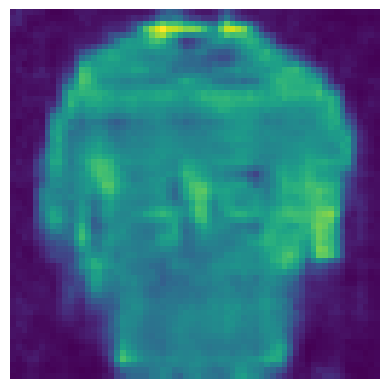

In [261]:
generate_and_show_image(gen, weight_path, nz, device)

<ipython-input-13-3b06d6d0364e>:13: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  generator.load_state_dict(torch.load(weight_path, map_location=device))


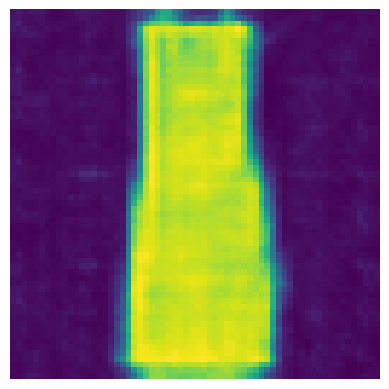

In [215]:
generate_and_show_image(gen, weight_path, nz, device)

<ipython-input-13-3b06d6d0364e>:13: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  generator.load_state_dict(torch.load(weight_path, map_location=device))


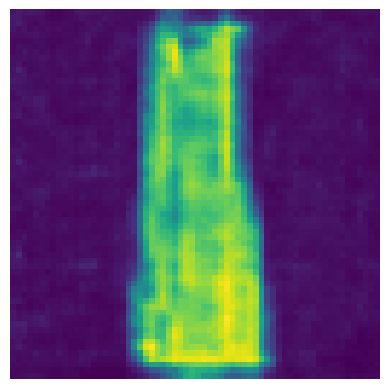

In [232]:
generate_and_show_image(gen, weight_path, nz, device)

## WGAN (weight clipping) Architecture 1

<ipython-input-13-3b06d6d0364e>:13: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  generator.load_state_dict(torch.load(weight_path, map_location=device))


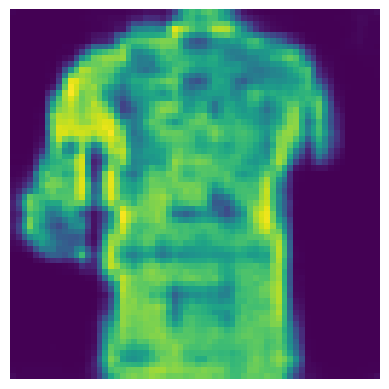

In [285]:
gen = Generator_WGAN(nz, ngf, nc)  # Adjust as needed
weight_path = './generator_weights_a1_wgan.pth'
nz = 100
device = 'cuda' if torch.cuda.is_available() else 'cpu'
generate_and_show_image(gen, weight_path, nz, device)

<ipython-input-13-3b06d6d0364e>:13: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  generator.load_state_dict(torch.load(weight_path, map_location=device))


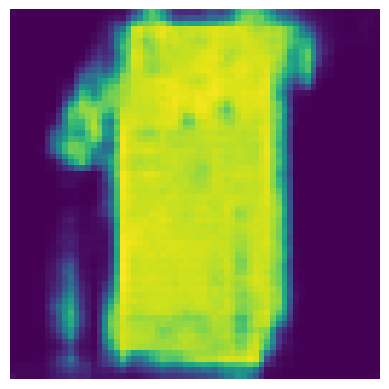

In [329]:
gen = Generator_WGAN(nz, ngf, nc)  # Adjust as needed
weight_path = './generator_weights_a1_wgan.pth'
nz = 100
device = 'cuda' if torch.cuda.is_available() else 'cpu'
generate_and_show_image(gen, weight_path, nz, device)

<ipython-input-13-3b06d6d0364e>:13: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  generator.load_state_dict(torch.load(weight_path, map_location=device))


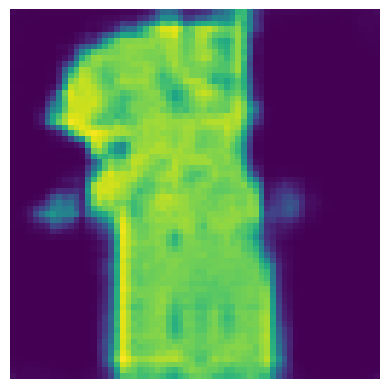

In [320]:
gen = Generator_WGAN(nz, ngf, nc)  # Adjust as needed
weight_path = './generator_weights_a1_wgan.pth'
nz = 100
device = 'cuda' if torch.cuda.is_available() else 'cpu'
generate_and_show_image(gen, weight_path, nz, device)

<ipython-input-13-3b06d6d0364e>:13: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  generator.load_state_dict(torch.load(weight_path, map_location=device))


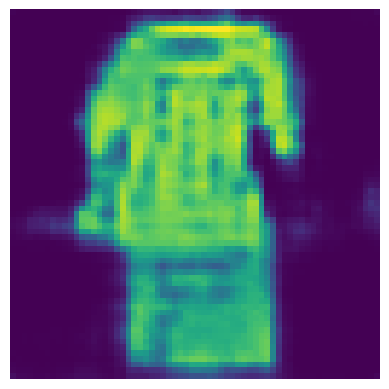

In [298]:
gen = Generator_WGAN(nz, ngf, nc)  # Adjust as needed
weight_path = './generator_weights_a1_wgan.pth'
nz = 100
device = 'cuda' if torch.cuda.is_available() else 'cpu'
generate_and_show_image(gen, weight_path, nz, device)

## WGAN (gradient penalty) Architecture 1

<ipython-input-13-3b06d6d0364e>:13: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  generator.load_state_dict(torch.load(weight_path, map_location=device))


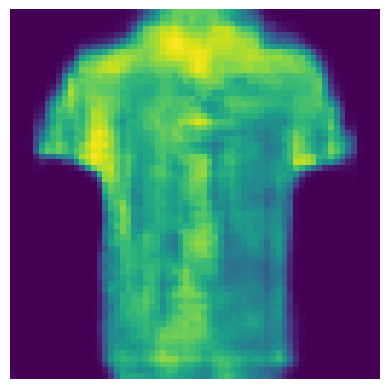

In [358]:
gen = Generator_WGAN(nz, ngf, nc)  # Adjust as needed
weight_path = './generator_weights_a1_wgan_gp.pth'
nz = 100
device = 'cuda' if torch.cuda.is_available() else 'cpu'
generate_and_show_image(gen, weight_path, nz, device)

<ipython-input-13-3b06d6d0364e>:13: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  generator.load_state_dict(torch.load(weight_path, map_location=device))


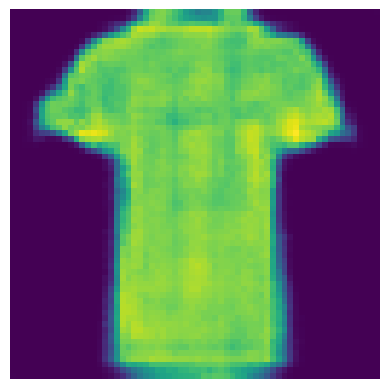

In [393]:
gen = Generator_WGAN(nz, ngf, nc)  # Adjust as needed
weight_path = './generator_weights_a1_wgan_gp.pth'
nz = 100
device = 'cuda' if torch.cuda.is_available() else 'cpu'
generate_and_show_image(gen, weight_path, nz, device)

<ipython-input-13-3b06d6d0364e>:13: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  generator.load_state_dict(torch.load(weight_path, map_location=device))


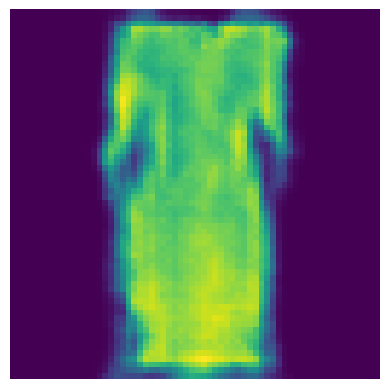

In [369]:
gen = Generator_WGAN(nz, ngf, nc)  # Adjust as needed
weight_path = './generator_weights_a1_wgan_gp.pth'
nz = 100
device = 'cuda' if torch.cuda.is_available() else 'cpu'
generate_and_show_image(gen, weight_path, nz, device)

<ipython-input-13-3b06d6d0364e>:13: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  generator.load_state_dict(torch.load(weight_path, map_location=device))


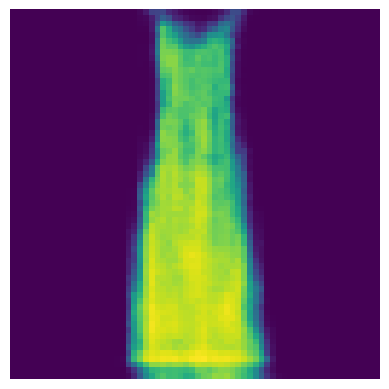

In [341]:
gen = Generator_WGAN(nz, ngf, nc)  # Adjust as needed
weight_path = './generator_weights_a1_wgan_gp.pth'
nz = 100
device = 'cuda' if torch.cuda.is_available() else 'cpu'
generate_and_show_image(gen, weight_path, nz, device)